In [6]:
import pandas as pd
from ipoly import load
import skimage
import numpy as np

In [7]:
image = load("amborella081.jpg")
unique, counts = np.unique(np.array(image).reshape(-1,3), axis=0, return_counts=True)

In [32]:
np.quantile(counts, 0.99)

4267.44999999999

In [34]:
counts.shape

(54566,)

In [58]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=10, random_state=0).fit(unique)

In [59]:
labels = kmeans.predict(unique)

In [47]:
labels

array([4, 4, 4, ..., 3, 3, 3])

In [63]:
from skimage import filters

In [66]:
threshold = filters.threshold_otsu(skimage.color.rgb2gray(image))

In [68]:
gim = skimage.color.rgb2gray(image)

In [82]:
threshold

0.4946887806372549

Text(0, 0.5, 'pixel count')

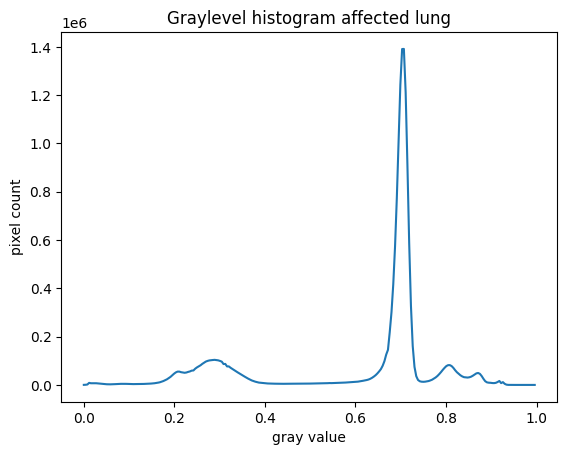

In [81]:
# show the histogram of the blurred image
import matplotlib.pyplot as plt
histogram, bin_edges = np.histogram(gim, bins=256, range=(0.0, 1.0))
fig, ax = plt.subplots()
plt.plot(bin_edges[0:-1], histogram)
plt.title("Graylevel histogram affected lung")
plt.xlabel("gray value")
plt.ylabel("pixel count")

In [144]:
import skimage.morphology as morph
from skimage.segmentation import clear_border
binary_mask = gim < threshold
binary_mask = morph.remove_small_objects(binary_mask, 2000)
labeled_image, count = skimage.measure.label(binary_mask, return_num=True)

In [136]:
uniques, counts = np.unique(labeled_image, return_counts=True)

In [137]:
uniques

array([0, 1, 2, 3, 4, 5])

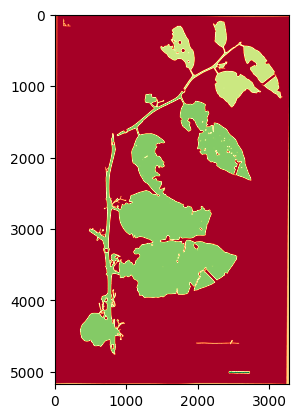

In [145]:
plt.imshow(labeled_image, cmap='RdYlGn')

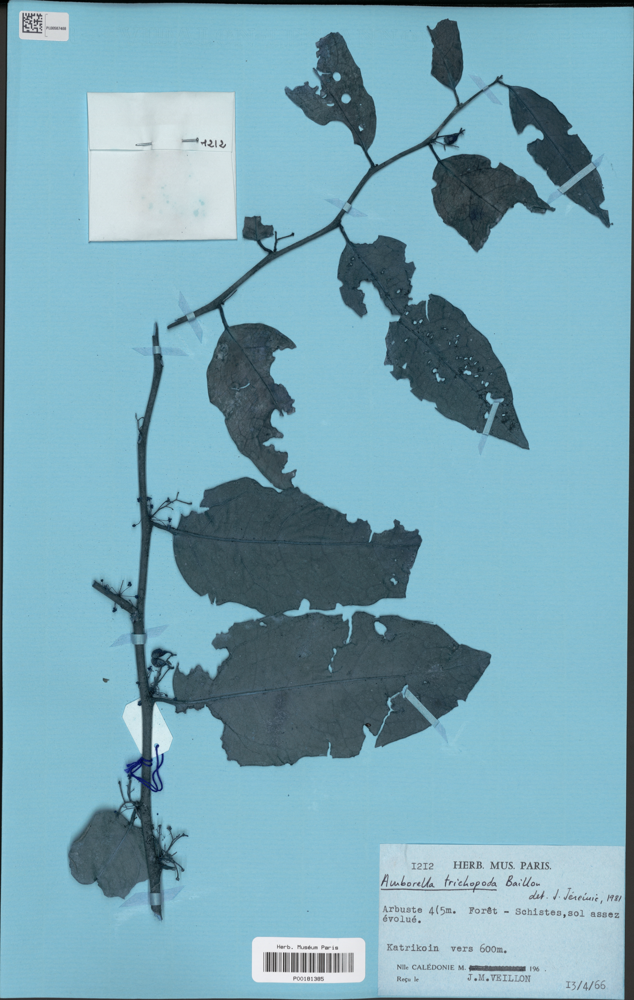

In [57]:
from PIL import Image
Image.fromarray(image)

In [60]:
pd.DataFrame(labels).groupby(0)[0].count()

0
0    7152
1    5777
2    3891
3    5556
4    4082
5    5370
6    5904
7    5093
8    7489
9    4252
Name: 0, dtype: int64

In [61]:
unique[counts > np.quantile(counts, 0.999)]

array([[128, 186, 205],
       [129, 187, 206],
       [129, 188, 208],
       [130, 186, 205],
       [130, 187, 208],
       [130, 188, 207],
       [130, 189, 209],
       [131, 187, 204],
       [131, 187, 206],
       [131, 188, 209],
       [131, 189, 208],
       [131, 190, 209],
       [131, 190, 210],
       [132, 188, 205],
       [132, 188, 207],
       [132, 189, 210],
       [132, 190, 209],
       [132, 191, 207],
       [132, 191, 211],
       [133, 187, 204],
       [133, 189, 206],
       [133, 189, 208],
       [133, 190, 211],
       [133, 191, 210],
       [133, 192, 208],
       [133, 192, 212],
       [134, 188, 205],
       [134, 190, 207],
       [134, 190, 209],
       [134, 191, 212],
       [134, 192, 211],
       [135, 189, 206],
       [135, 191, 208],
       [135, 191, 210],
       [135, 192, 213],
       [135, 193, 212],
       [136, 189, 209],
       [136, 190, 207],
       [136, 192, 209],
       [136, 192, 211],
       [136, 194, 213],
       [137, 190

In [ ]:
labeled_image, count = skimage.measure.label(binary_mask, return_num=True)

In [62]:
def weighted_jaccard_index(x,y):
    mins, maxs = 0, 0
    for i in np.arange(len(x)):
        mins += np.amin([x[i],y[i]])
        maxs += np.amax([x[i],y[i]])
    return mins/maxs

In [ ]:
binary_mask = np.any(image == unique[-1], axis = 2)